In [1]:
# Reload the notebook automatically
%load_ext autoreload
%autoreload 2

# Import

In [2]:
import sys
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt
import cv2
from IPython.display import clear_output

WORK_DIR = Path(Path.cwd()).parent
sys.path.append(str(WORK_DIR))
from src import ROOT, parse
from src.models import get_model
from src.datasets.transforms import *
from src.datasets import get_dataset, get_dataloader
from src.utils import *

cfg_dir = 'mlcv-exp/data/cfg/'

# Setup

In [3]:
dataset = 'fpha'
model_name = 'hpo_hand'
exp = 'exp2'
epoch = 200
cfg_name = '{}_{}_{}.cfg'.format(dataset, model_name, exp)
cfg = parse(Path(ROOT)/cfg_dir/model_name/cfg_name)
cfg['aug'] = None
cfg['batch_size'] = 1
cfg['shuffle'] = None
model = get_model(cfg, 'test', epoch)

In [4]:
model_net_mode = 'eval'
if model_net_mode == 'eval':
    model.net.eval()
elif model_net_mode == 'train':
    model.net.train()
clear_output()

# Loading

In [5]:
# dataloader = get_dataloader(cfg, get_dataset(cfg, 'test'))
dataloader = None

In [8]:
img_path = Path('datasets/First_Person_Action_Benchmark')/'Video_files_rsz'/'Subject_1/open_juice_bottle/1/color/color_0009.jpeg'
# img_path = Path('EPIC_KITCHENS_2018')/'EK_frames'/'P03/P03_10_7118_open_juice'/'img_{:05d}.jpg'.format(0)
# img_path = Path('EPIC_KITCHENS_2018')/'EK_frames'/'P03/P03_10_7118_open_juice'/'img_{:05d}.jpg'.format(100)
# img_path = Path('EPIC_KITCHENS_2018')/'EK_frames'/'P01/P01_03_502_put-down_milk'/'img_{:05d}.jpg'.format(49)
# img_path = Path('EPIC_KITCHENS_2018')/'EK_frames'/'P20/P20_03_21943_open_drawer'/'img_{:05d}.jpg'.format(100)

In [9]:
if dataloader:
    img, *others = next(iter(dataloader))
    img = img.cuda()
else:    
    img = get_img_dataloader(str(Path(ROOT)/img_path), 416)
    img = img.unsqueeze(0).cuda()

# Show Img

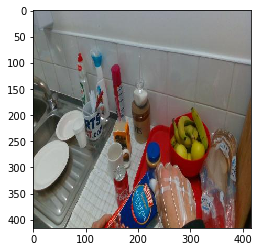

In [10]:
img_show = ImgToNumpy()(img.cpu())[0]
fig, ax = plt.subplots()
ax.imshow(img_show)
plt.show()

# Detect

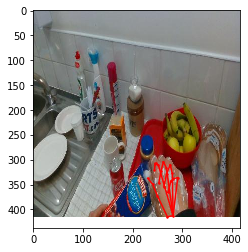

In [17]:
model.detect(img)

In [28]:
# seq_name = 'P20/P20_03_21943_open_drawer'
# seq_name = 'P03/P03_10_7118_open_juice'
seq_name = 'P01/P01_09_1521_cut_dough'
# seq_name = 'P01/P01_03_502_put-down_milk'
# seq_name = 'P29/P29_04_35766_search-for_scissors'
# seq_name = 'P02/P02_09_5236_pour_salt'
# seq_name = 'P22/P22_07_25388_wash_sponge'
# seq_name = 'P23/P23_02_29040_search-for_table'
# seq_name = 'P23/P23_04_29398_take_cover'
# seq_name = 'P23/P23_03_29247_put_box'
# seq_name = 'P23/P23_04_29257_take-out_tap'
# seq_name = 'P23/P23_01_28990_close_tap'
# seq_name = 'P23/P23_02_29021_take_garlic'
# seq_name = 'P20/P20_01_21716_press_spatula'
# seq_name = 'P20/P20_03_21961_put-down_milk'
# seq_name = 'P20/P20_04_22239_pick-up_oil'
# seq_name = 'P01/P01_19_3944_take_sponge'
seq_path = Path(ROOT)/'datasets'/'EPIC_KITCHENS_2018'/'EK_frames'/seq_name

In [29]:
# seq_name = 'Subject_1/open_juice_bottle/1/color'
# seq_name = 'Subject_4/put_salt/2/color'
# seq_name = 'Subject_5/open_milk/4/color'
# seq_name = 'Subject_2/wash_sponge/4/color'
# seq_name = 'Subject_2/handshake/1/color'
# seq_name = 'Subject_2/use_flash/2/color'
# # seq_name = 'Subject_2/charge_cell_phone/1/color'
# seq_path =  Path(ROOT)/'datasets'/'First_Person_Action_Benchmark'/'Video_files_rsz'/seq_name

t:   1%|          | 3/562 [00:00<00:20, 27.06it/s, now=None]

MoviePy - Building file /mnt/4TB/aaron/mlcv-exp/data/saved/P01_P01_09_1521_cut_dough/detect_P01_P01_09_1521_cut_dough_fpha_hpo_hand_exp2_200_eval.gif with imageio.


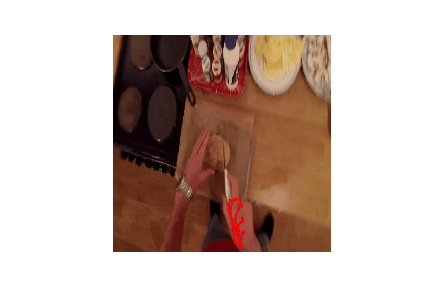

In [32]:
pad=10
model.detect_video(seq_path, seq_name, model_info='{}_{}_{}_{}_{}'.format(dataset, model_name, exp, epoch, model_net_mode), pad=pad)
# model.detect_video(seq_path, img_size=416)

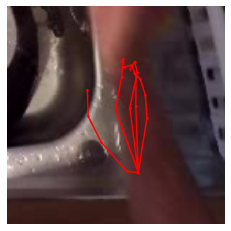

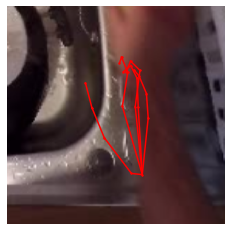

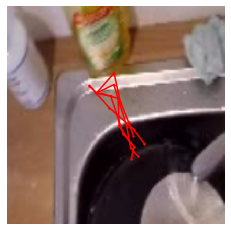

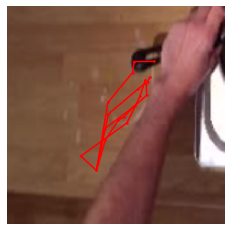

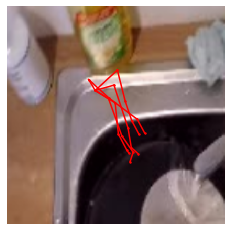

...

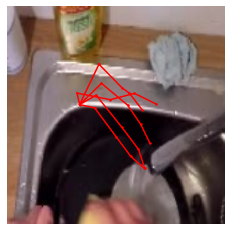

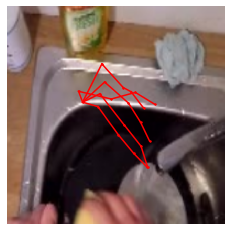

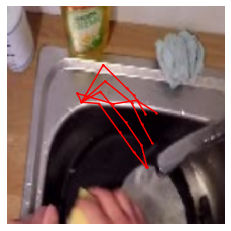

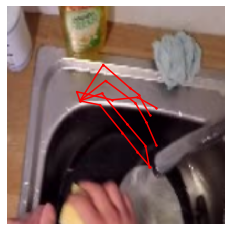

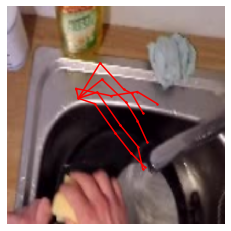

In [22]:
pad=50
model.detect_video_get_crop(seq_path, seq_name, model_info='{}_{}_{}_{}_{}'.format(dataset, model_name, exp, epoch, model_net_mode), pad=pad)
# model.detect_video(seq_path, img_size=416)